In [4]:
import easyocr 
import cv2

import os
from os import path

import matplotlib.pyplot as plt

## EasyOCR
Данная библиотека позволяет выполнять распознавание за пару строк

In [5]:
reader = easyocr.Reader(['ru'], gpu=False, model_storage_directory='./OCR model/')

Using CPU. Note: This module is much faster with a GPU.


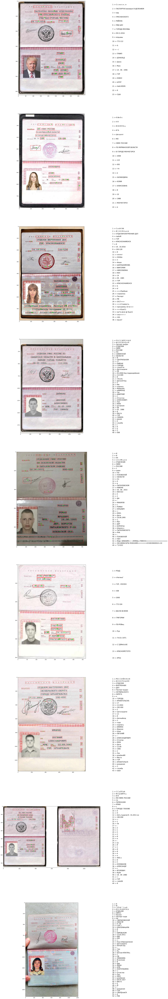

In [6]:
data_folder = '../data/test/'


target_files_list = [file_name for file_name in os.listdir(data_folder) if '.jpeg' in file_name]
img_count = len(target_files_list)

fig, axes = plt.subplots(img_count, 2, gridspec_kw={'width_ratios': [4, 1]}, figsize=(24, img_count * 20))

for ind, file_name in enumerate(target_files_list):
    temp_image = cv2.imread(path.normpath(data_folder + f'\\{file_name}'))
    
    cur_results = reader.readtext(temp_image)

    for box_ind, (bbox, text, prob) in enumerate(cur_results, 1):
        # unpack the bounding box
        (tl, tr, br, bl) = bbox
        tl = (int(tl[0]), int(tl[1]))
        tr = (int(tr[0]), int(tr[1]))
        br = (int(br[0]), int(br[1]))
        bl = (int(bl[0]), int(bl[1]))

        cv2.rectangle(temp_image, tl, br, (0, 0, 255), 1)
        cv2.putText(temp_image, str(box_ind), ((tl[0] + tr[0]) // 2, (tl[1] + br[1]) // 2),
        cv2.FONT_HERSHEY_COMPLEX, 0.3, (0, 255, 0))
        
        axes[ind, 1].text(0, 1 - box_ind / len(cur_results), 
                          f'{box_ind} -> {text}', fontsize=15, transform=axes[ind, 1].transAxes)
        

    img_obj = cv2.cvtColor(temp_image, cv2.COLOR_BGR2RGB)

    
    
    img_width, img_height, _ = img_obj.shape

    cv2.resize(img_obj, (int(3 * img_width), int(3 * img_height)))

    axes[ind, 0].imshow(img_obj)
    axes[ind, 1].axis('off')

Библиотека работает намного эффективнее чем API, у неё:
* Качество выше
* Распознавание лучше
* Нет зависимости от интернета
* Лучше работает с бликами и низкокачественными изображениями

# Pytesseract
Сравним Pytesseract с EasyOCR

In [14]:
# Windows tesseract installer https://github.com/UB-Mannheim/tesseract/wiki
import pytesseract
from PIL import Image
import pandas as pd

pytesseract.pytesseract.tesseract_cmd = r'D:/JupyterParty/RusPassportOCR/Tesseract-OCR/tesseract.exe'

In [39]:
res = [item.split('\t') for item in pytesseract.image_to_data(Image.open(path.normpath(data_folder + f'\\0.jpeg')), lang='rus').split('\n')]
# Convert to df for easier usage
df = pd.DataFrame(data=res[1:], columns=res[0])
df['conf'] = df.conf.astype('float32')
df

,level,page_num,block_num,par_num,line_num,word_num,left,top,width,height,conf,text
0,1,1,0,0,0,0,0,0,447,624,-1.000000,
1,2,1,1,0,0,0,73,35,298,8,-1.000000,
2,3,1,1,1,0,0,73,35,298,8,-1.000000,
3,4,1,1,1,1,0,73,35,298,8,-1.000000,
4,5,1,1,1,1,1,73,35,147,7,34.736336,российскля
5,5,1,1,1,1,2,243,36,128,7,79.500046,ФЕДЕРАЦИЯ
6,2,1,2,0,0,0,84,64,278,80,-1.000000,
7,3,1,2,1,0,0,110,64,252,55,-1.000000,
8,4,1,2,1,1,0,110,64,252,10,-1.000000,
9,5,1,2,1,1,1,110,64,153,9,89.519493,ПАСПОРТНО-ВИЗОВЫМ


In [40]:
df[df.conf > 30.]

,level,page_num,block_num,par_num,line_num,word_num,left,top,width,height,conf,text
4,5,1,1,1,1,1,73,35,147,7,34.736336,российскля
5,5,1,1,1,1,2,243,36,128,7,79.500046,ФЕДЕРАЦИЯ
9,5,1,2,1,1,1,110,64,153,9,89.519493,ПАСПОРТНО-ВИЗОВЫМ
10,5,1,2,1,1,2,272,64,90,10,95.953491,ОТДЕЛЕНИЕМ
12,5,1,2,1,2,1,134,85,26,11,83.778061,ОВД
13,5,1,2,1,2,2,171,85,107,10,92.931221,ПРЕСНЕНСКОГО
14,5,1,2,1,2,3,289,83,53,12,90.797195,РАЙОНА
16,5,1,2,1,3,1,142,108,27,10,94.946281,УВД
17,5,1,2,1,3,2,179,108,26,10,94.946281,ЦАО
18,5,1,2,1,3,3,215,108,54,11,95.580078,ГОРОДА


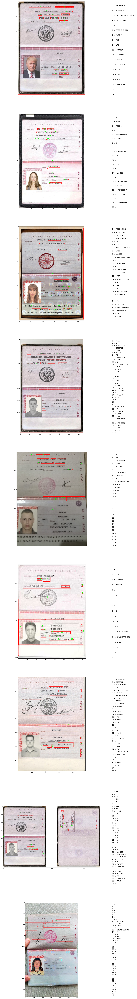

In [58]:
fig, axes = plt.subplots(img_count, 2, gridspec_kw={'width_ratios': [4, 1]}, figsize=(24, img_count * 20))

for ind, file_name in enumerate(target_files_list):
    temp_image_path = data_folder + f'\\{file_name}'
    
    temp_image = cv2.imread(path.normpath(temp_image_path))
    
    cur_results = [item.split('\t') for item in pytesseract.image_to_data(Image.open(temp_image_path), lang='rus').split('\n')]
    # Convert to df for easier usage
    cur_results_df = pd.DataFrame(data=cur_results[1:], columns=cur_results[0])
    cur_results_df = cur_results_df.dropna() 
    # Configure types
    cur_results_df['conf'] = cur_results_df.conf.astype('float32')
    cur_results_df['left'] = cur_results_df.left.astype('int16')
    cur_results_df['top'] = cur_results_df.top.astype('int16')
    cur_results_df['width'] = cur_results_df.width.astype('int16')
    cur_results_df['height'] = cur_results_df.height.astype('int16')
    
    # Clear low confident boxes
    cur_results_df = cur_results_df[cur_results_df.conf > 30.]

    for box_ind, temp_row in enumerate(cur_results_df.iterrows(), 1):
        temp_row = temp_row[1]
        (left, top, height, width) = temp_row['left'], temp_row['top'], temp_row['height'], temp_row['width']

        cv2.rectangle(temp_image, (left, top), (left + width, top + height), (0, 0, 255), 1)
        cv2.putText(temp_image, str(box_ind), (left + width // 2, top + height // 2),
        cv2.FONT_HERSHEY_COMPLEX, 0.3, (0, 255, 0))
        
        axes[ind, 1].text(0, 1 - box_ind / cur_results_df.shape[0], 
                          f'{box_ind} -> {temp_row["text"]}', fontsize=15, transform=axes[ind, 1].transAxes)
        

    img_obj = cv2.cvtColor(temp_image, cv2.COLOR_BGR2RGB)

    
    
    img_width, img_height, _ = img_obj.shape

    cv2.resize(img_obj, (int(3 * img_width), int(3 * img_height)))

    axes[ind, 0].imshow(img_obj)
    axes[ind, 1].axis('off')

Проанализировав изображения можно прийти к выводам, что библиотека PyTesseract:
* Неудобная, тк её вывод это строка
* Неточная, тк есть промахи
* Находит фантомные символы, которые являются линиями